In [1]:
import pandas as pd
import cupy as cp
import numpy as np
np.warnings.filterwarnings('ignore')
import matplotlib
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
from jupyterthemes import jtplot
jtplot.style(theme="monokai", context="notebook", ticks=True, grid=True)
import math
import scipy.io
import time
import xarray as xr
import matplotlib.animation as animation
from matplotlib.colors import LinearSegmentedColormap
from IPython.display import HTML
from IPython.display import Image
matplotlib.rcParams['animation.embed_limit'] = 80
color = scipy.io.loadmat('/home/lucy/Documents/Advanced Machine/DMD/CODE_DMD/CH02_FLUIDS/CCcool.mat')
cc = color['CC']
newcmp = LinearSegmentedColormap.from_list('', cc)
import xarray as xr
#from scipy.io import netcdf
import netCDF4 as nc

In [2]:
from datetime import datetime, timedelta
def create_animation(data, temp, frame_step, start_time='1990/01/01', end_time=None, output_format='html'):
    jet = ["blue", "#007FFF", "cyan","#7FFF7F", "yellow", "#FF7F00", "red", "#7F0000"]
    cm = LinearSegmentedColormap.from_list('my_jet', jet, N=256)

    # Parse the start time
    start_date = datetime.strptime(start_time, '%Y/%m/%d')

    if end_time is None:
        num_weeks = data.shape[0]
        end_date = start_date + timedelta(weeks=num_weeks)
    else:
        end_date = datetime.strptime(end_time, '%Y/%m/%d')
        num_weeks = int((end_date - start_date).days / 7)

    fig, ax = plt.subplots(figsize=(15, 7))

    # Initial frame
    cax = ax.contourf(temp['lon'].data, temp['lat'].data, data[0, :, :], 
                      levels=20, linewidths=1, vmin=0, cmap=cm)
    fig.colorbar(cax)

    def update(frame):
        ax.clear()
        cax = ax.contourf(temp['lon'].data, temp['lat'].data, data[frame * frame_step, :, :], 
                          levels=20, linewidths=1, vmin=0, cmap=cm)
        
        # date for this frame
        date = start_date + timedelta(weeks=frame * frame_step)
        
        ax.set_title('Week = {}, Date = {}'.format(frame * frame_step, date.strftime('%Y-%m-%d')))


    ani = animation.FuncAnimation(fig, update, frames=range(num_weeks // frame_step), interval=200)
    plt.close()

    if output_format == 'html':
        return HTML(ani.to_jshtml())
    elif output_format == 'gif':
        ani.save('animation.gif', writer='pillow')


# Example usage:
#create_animation(sst, '2021/01/01', '2023/06/24', 4, 'gif')

In [3]:
maska = '/home/lucy/Documents/Advanced Machine/DMD/VAR/lsmask.nc'
data_set = '/home/lucy/Documents/Advanced Machine/DMD/VAR/sst.wkmean.1990-present.nc'
ds = xr.open_dataset(data_set)
ds

<xarray.Dataset>
Dimensions:    (lat: 180, lon: 360, time: 1727, nbnds: 2)
Coordinates:
  * lat        (lat) float32 89.5 88.5 87.5 86.5 ... -86.5 -87.5 -88.5 -89.5
  * lon        (lon) float32 0.5 1.5 2.5 3.5 4.5 ... 356.5 357.5 358.5 359.5
  * time       (time) datetime64[ns] 1989-12-31 1990-01-07 ... 2023-01-29
Dimensions without coordinates: nbnds
Data variables:
    sst        (time, lat, lon) float32 ...
    time_bnds  (time, nbnds) datetime64[ns] ...
Attributes:
    title:          NOAA Optimum Interpolation (OI) SST V2
    Conventions:    CF-1.0
    history:        Created 10/2002 by RHS
    comments:       Data described in  Reynolds, R.W., N.A. Rayner, T.M.\nSmi...
    platform:       Model
    source:         NCEP Climate Modeling Branch
    institution:    National Centers for Environmental Prediction
    References:     https://www.psl.noaa.gov/data/gridded/data.noaa.oisst.v2....
    NCO:            4.0.0
    dataset_title:  NOAA Optimum Interpolation (OI) SST V2
    source_url:     http://www.emc.ncep.noaa.gov/research/cmb/sst_analysis/

In [4]:
# # Open the NetCDF file
# dataset = xr.open_dataset('/home/lucy/Documents/Advanced Machine/DMD/VAR/sst.wkmean.1990-present.nc')

# # Get the total number of records
# total_records = dataset.time.size

# # Calculate the number of records per part
# records_per_part = round(total_records / 10)

# # Create and write the three parts
# for i in range(10):
#     start_index = i * records_per_part
#     end_index = (i + 1) * records_per_part
#     part = dataset.isel(time=slice(start_index, end_index))
#     part.to_netcdf(f'/home/lucy/Documents/Advanced Machine/DMD/VAR/sst_{i+1}.nc')

# # Close the original dataset
# dataset.close()


# #Open the NetCDF file
# dataset = xr.open_dataset('/home/lucy/Documents/Advanced Machine/DMD/VAR/sst.wkmean.1990-present.nc')

# # Get the total number of records
# total_records = dataset.time.size

# # Calculate the number of records per part
# records_per_part = total_records // 10

# # Create 10 parts
# parts = []
# for i in range(10):
#     start_index = i * records_per_part
#     end_index = (i + 1) * records_per_part if i != 9 else total_records
#     part = dataset.isel(time=slice(start_index, end_index))
#     parts.append(part)

# # Merge 6 parts into sst_1.nc
# sst_1 = xr.concat(parts[:8], dim="time")
# sst_1.to_netcdf('/home/lucy/Documents/Advanced Machine/DMD/VAR/sst_1.nc')

# # Merge 4 parts into sst_2.nc
# sst_2 = xr.concat(parts[8:], dim="time")
# sst_2.to_netcdf('/home/lucy/Documents/Advanced Machine/DMD/VAR/sst_2.nc')

# # Close the original dataset
# dataset.close()

In [4]:
def load_geo_data(dataset, maska):

    mask_ds = xr.open_dataset(maska)
    mask = mask_ds['mask'].values[0, :, :]
    mask = mask.astype(float)
    mask[mask == 0] = np.nan

    ds = xr.open_dataset(dataset)
    temp = ds['sst'].values[:, :, :] 

    dane_decomp = temp
    dane_plot = dane_decomp * mask

    time_values = ds.time.values

    return dane_decomp, dane_plot, ds, mask, time_values

In [7]:
_, dane_plot, lon_lat, _ , dates = load_geo_data('/home/lucy/Documents/Advanced Machine/DMD/VAR/sst.wkmean.1990-present.nc',\
                                         '/home/lucy/Documents/Advanced Machine/DMD/VAR/lsmask.nc')
print(dane_plot.shape)
start_time = pd.Timestamp(dates[0]).strftime('%Y/%m/%d')
end_time = pd.Timestamp(dates[-1]).strftime('%Y/%m/%d')
print(start_time)
print(end_time)

(1727, 180, 360)
1989/12/31
2023/01/29


In [5]:
from datetime import datetime, timedelta
#import matplotlib.pyplot as plt
#from matplotlib.colors import LinearSegmentedColormap
import matplotlib.animation as animation
from IPython.display import HTML
#import pandas as pd

def create_animation(data, temp, time_values, frame_step, start_time=None, end_time=None, output_format='html'):

    jet = ["blue", "#007FFF", "cyan","#7FFF7F", "yellow", "#FF7F00", "red", "#7F0000"]
    cm = LinearSegmentedColormap.from_list('my_jet', jet, N=256)


    time_values = pd.to_datetime(time_values)

    # If start_time or end_time is not provided, use the time values from the data
    if start_time is None:
        start_date = time_values[0]
    else:
        start_date = pd.to_datetime(start_time)

    if end_time is None:
        end_date = time_values[-1]
    else:
        end_date = pd.to_datetime(end_time)

    # mask that selects only the dates between start_date and end_date
    mask = (time_values >= start_date) & (time_values <= end_date)

    # Apply the mask to the time_values and data arrays
    time_values = time_values[mask]
    data = data[mask, :, :]

    # Create new time_values and data arrays that only include every frame_step-th element
    time_values_step = time_values[::frame_step]
    data_step = data[::frame_step, :, :]

    fig, ax = plt.subplots(figsize=(15, 7))

    # Initial frame
    cax = ax.contourf(temp['lon'].data, temp['lat'].data, data_step[0, :, :], 
                      levels=20, linewidths=1, vmin=0, cmap=cm)
    fig.colorbar(cax)

    def update(frame):
        ax.clear()
        cax = ax.contourf(temp['lon'].data, temp['lat'].data, data_step[frame, :, :], 
                          levels=20, linewidths=1, vmin=0, cmap=cm)
        
        # Get the date for this frame from time_values_step
        date = time_values_step[frame]
        
        ax.set_title('Frame = {}, Date = {}'.format(frame, date.strftime('%Y-%m-%d')))

    ani = animation.FuncAnimation(fig, update, frames=range(len(time_values_step)), interval=200)
    plt.close()

    if output_format == 'html':
        return HTML(ani.to_jshtml())
    elif output_format == 'gif':
        ani.save('animation.gif', writer='pillow')


In [10]:
create_animation(dane_plot, lon_lat, dates, 5)

In [6]:
class DMD:
    def __init__(self, X_data, r, method='dmd_1'):
        self.X_data = X_data
        self.r = r
        self.method = method

    def dmd_1(self):
        N, T = self.X_data.shape
        ## Build data matrices
        X1 = self.X_data[:, : -1]
        X2 = self.X_data[:, 1 :]
        ## Perform singular value decomposition on X1
        u, s, v = cp.linalg.svd(X1, full_matrices = False)
        ## Compute the Koopman matrix
        A_tilde = cp.linalg.solve(cp.diag(s[:self.r]).T,(u[:,:self.r].T @ X2 @ v[:self.r,:].T).T).T # Step 2
        #A_tilde = u[:, : r].conj().T @ X2 @ v[: r, :].conj().T * np.reciprocal(s[: r])
        ## Perform eigenvalue decomposition on A_tilde
        Lambda, W = cp.linalg.eig(A_tilde)
        ## Compute the coefficient matrix
        Phi = X2 @ cp.linalg.solve(cp.diag(s[:self.r]).T, v[:self.r,:]).T @ W # Step 4
        #Phi = X2 @ v[: r, :].conj().T @ np.diag(np.reciprocal(s[: r])) @ W
        #A = Phi @ np.diag(Lambda) @ np.linalg.pinv(Phi)
        return N, T, Phi, Lambda, X1

    def dmd_2(self):
        N, T = self.X_data.shape
        X1 = self.X_data[:, : -1]
        X2 = self.X_data[:, 1 :]
        U, Sigma, VT = cp.linalg.svd(X1, full_matrices=0) # Step 1
        Ur = U[:,:self.r]
        Sigmar = cp.diag(Sigma[:self.r])
        VTr = VT[:self.r,:]
        Atilde = cp.linalg.solve(Sigmar.T,(Ur.T @ X2 @ VTr.T).T).T # Step 2
        Atilde = cp.asnumpy(Atilde)
        Lambda, W = np.linalg.eig(Atilde) # Step 3
        W = cp.asarray(W)
        Lambda = cp.asarray(Lambda)
        Lambda = cp.diag(Lambda)
        Phi = X2 @ cp.linalg.solve(Sigmar.T,VTr).T @ W # Step 4
        alpha1 = Sigmar @ VTr[:,0]
        b = cp.linalg.solve(W @ Lambda,alpha1)
        return N, T, Phi, Lambda, b, X1

    def __call__(self, func_to_decor):
        def wrapper(*args, **kwargs):
            if self.method == 'dmd_1':
                N_total, T, Phi, Lambda, X1 = self.dmd_1()
                return func_to_decor(N_total, T, Phi, Lambda, X1, *args, **kwargs)
            elif self.method == 'dmd_2':
                N_total, T, Phi, Lambda, b, X1 = self.dmd_2()
                return func_to_decor(N_total, T, Phi, Lambda, b, X1, *args, **kwargs)
        return wrapper

    def plot(self, mat, T, pred_step):
        # Plot the original data and the predictions
        plt.figure(figsize=(10, 6))
        plt.plot(mat[0, :], label='Original Data')
        plt.plot(range(T, T + pred_step), mat[0, T:], label='Predictions')
        plt.legend()
        plt.show()
    
    def plot_complex(self, N_total, T, Phi, Lambda, b, X1, *args):
        Lambda = cp.asnumpy(Lambda)
        fig = plt.figure(figsize = (4, 4))
        ax = fig.add_subplot(1, 1, 1)
        ax.set_aspect('equal', adjustable = 'box')
        plt.plot(Lambda.real, Lambda.imag, 'o', color = 'red', markersize = 6)
        circle = plt.Circle((0, 0), 1, color = 'blue', linewidth = 2.5, fill = False)
        ax.add_patch(circle)
        plt.grid(axis = 'both', linestyle = "--", linewidth = 0.1, color = 'gray')
        ax.tick_params(direction = "in")
        plt.xlabel('Real axis')
        plt.ylabel('Imaginary axis')
        plt.close()

        return Phi

In [7]:
tensor_data, dane_plot, data, mask , dates = load_geo_data('/home/lucy/Documents/Advanced Machine/DMD/VAR/sst.wkmean.1990-present.nc',\
                                         '/home/lucy/Documents/Advanced Machine/DMD/VAR/lsmask.nc')
print(np.nanmin(dane_plot), np.nanmax(dane_plot))

start_time = pd.Timestamp(dates[0]).strftime('%Y/%m/%d')
end_time = pd.Timestamp(dates[-1]).strftime('%Y/%m/%d')
print(start_time)
print(end_time)

-1.7999999523162842 36.15999984741211
1989/12/31
2023/01/29


In [38]:
from datetime import datetime, timedelta
import numpy as np

def get_data_in_range(data, start_date_str, end_date_str):
    # Parse the start and end dates
    start_date = datetime.strptime(start_date_str, '%Y/%m/%d')
    end_date = datetime.strptime(end_date_str, '%Y/%m/%d')

    # Calculate the number of weeks between the start and end dates
    num_days = (end_date - start_date).days
    num_weeks = int(np.ceil(num_days / 7.0))

    # Select the data in the given range
    tensor = data['sst'].data[:num_weeks, :, :]

    return tensor, start_date_str, end_date_str

tensor, start_date, end_date = get_data_in_range(data, '2013/11/04', end_time)# '2020/01/01')

T, M, N = tensor.shape
print(tensor.shape)
print(T)

(482, 180, 360)
482


In [39]:
T, M, N = tensor.shape
mat = np.zeros((M * N, T))
for t in range(T):
    mat[:, t] = tensor[t, :, :].reshape([M * N])
print(mat.shape)
print(np.nanmin(tensor.data), np.nanmax(tensor.data))
mat = cp.asarray(mat)

(64800, 482)
-1.8 35.63


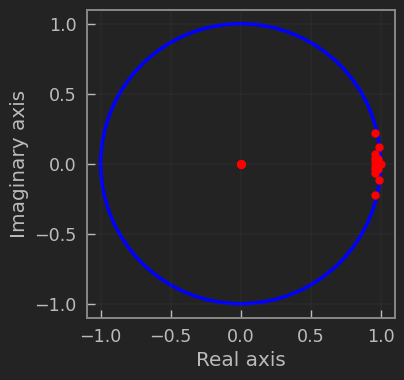

In [40]:
r = 15

# @DMD(mat,r, 'dmd_2')
# def dmd_2(N_total, T, Phi, Lambda, b, X1, *args):
#     return N_total, T, Phi, Lambda, b, T, X1

# N_total, T, Phi, eigval, b, T, X1 = dmd_2()

###############################################################
# for r in [rr + 10 for rr in np.arange(200, 480, 10)]:
#     dmd = DMD(mat, r)
#     N_total, T, Phi, Lambda, b, X1 = dmd.dmd_2()
#     dmd.plot_complex(N_total, T, Phi, Lambda, b, X1)
###############################################################

@DMD(mat,r, 'dmd_2')
def plot_complex(N_total, T, Phi, Lambda, b, X1, *args):
    Lambda = cp.asnumpy(Lambda)
    fig = plt.figure(figsize = (4, 4))
    ax = fig.add_subplot(1, 1, 1)
    ax.set_aspect('equal', adjustable = 'box')
    plt.plot(Lambda.real, Lambda.imag, 'o', color = 'red', markersize = 6)
    circle = plt.Circle((0, 0), 1, color = 'blue', linewidth = 2.5, fill = False)
    ax.add_patch(circle)
    plt.grid(axis = 'both', linestyle = "--", linewidth = 0.1, color = 'gray')
    ax.tick_params(direction = "in")
    plt.xlabel('Real axis')
    plt.ylabel('Imaginary axis')
    plt.show()

    return Phi

Phi = plot_complex()

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap

def plot_geomodes(W, data, mask, modes, odd=False):
    W = cp.asnumpy(W)
    levs = np.arange(16, 29, 0.05)
    jet=["blue", "#007FFF", "cyan","#7FFF7F", "yellow", "#FF7F00", "red", "#7F0000"] 
    cm = LinearSegmentedColormap.from_list('my_jet', jet, N=len(levs))

    # If odd is True, adjust the number of modes and the modes to display
    if odd:
        modes = modes // 2
        mode_indices = range(0, 2*modes, 2)
    else:
        mode_indices = range(modes)

    # Specify the number of rows and columns for the grid
    cols = 2
    rows = int(np.ceil(modes / cols))

    fig, axs = plt.subplots(rows, cols, figsize=(15, rows * 4))  # Adjust the height based on the number of rows

    # Flatten the 2D array of Axes objects to loop over them
    axs = axs.flatten()

    # Loop over all modes
    for i, t in enumerate(mode_indices):
        # Get the current Axes object
        ax = axs[i]
        if t % 2 ==0:

            vmin = -0.015
            vmax = 0.015
            cax = ax.contourf(data['lon'].data, data['lat'].data,
                            W[:, t].reshape((M, N)) * mask, levels = np.linspace(vmin, vmax, 15), 
                            linewidths = 1, cmap = cm)
        else:
            vmin = -0.01
            vmax = 0.015
            cax = ax.contourf(data['lon'].data, data['lat'].data,
                            W[:, t].reshape((M, N)) * mask, levels = np.linspace(vmin, vmax, 20), 
                            linewidths = 1, cmap = cm)

        ax.set_xticks([])
        ax.set_yticks([])
        cbar = fig.colorbar(cax, ax=ax, fraction = 0.1)
        cbar.ax.tick_params(labelsize=7)  # Adjust the size of the colorbar labels
        ax.set_title('Spatial mode {}'.format(t))

    # Remove unused subplots
    for i in range(modes, rows*cols):
        fig.delaxes(axs[i])

    # Adjust the spacing between subplots
    plt.subplots_adjust(wspace=0.1, hspace=0.1)
    plt.show()


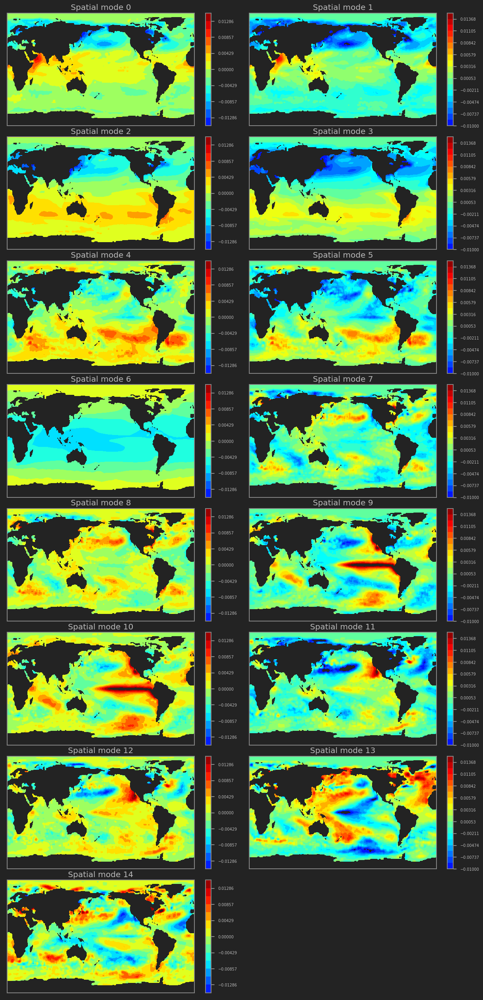

In [41]:
modes = r
plot_geomodes(Phi, data, mask, modes)#, 'odd')

In [42]:
@DMD(mat,r, 'dmd_2')
def reconstruction(N_total, T, Phi, Lambda, b, X1, num_modes, selected_modes=None):
    omega = cp.log(cp.diag(Lambda))
    mat_app = cp.zeros_like(mat)
    b = cp.linalg.pinv(Phi) @ X1[:, 0]

    for step in range(T):
        # Compute the time evolution of the modes
        if selected_modes is None:
            modes = [cp.exp(omega[i] * step) * b[i] for i in range(num_modes)]
            mat_app[:, step] = np.real(cp.squeeze(cp.sum(cp.asarray([Phi[:, i:i+1] * modes[i] for i in range(num_modes)]), axis=0)))
        else:
            modes = [cp.exp(omega[i] * step) * b[i] for i in selected_modes]
            mat_app[:, step] = np.real(cp.squeeze(cp.sum(cp.asarray([Phi[:, i:i+1] * modes[idx] for idx, i in enumerate(selected_modes)]), axis=0)))

    return mat_app

#reconstructed_data = reconstruction(50)
# reconstructed_data_single_mode = reconstruction(3, selected_modes=[0])
reconstructed_data = reconstruction(r, selected_modes=[5, 9])

tensor_reconstructed = cp.zeros((T, M, N))
for t in range(T):
    tensor_reconstructed[t, :, :] = reconstructed_data[:, t].reshape((M, N))

reconstructed_data = cp.asnumpy(tensor_reconstructed)
print(np.nanmin(reconstructed_data), np.nanmax(reconstructed_data))

-0.42097594186016063 0.5343680396579682


In [30]:
from datetime import datetime, timedelta
# mask = netcdf.NetCDFFile('/home/lucy/Documents/Advanced Machine/DMD/VAR/lsmask.nc', 'r').variables['mask'].data[0, :, :]
# mask = mask.astype(float)
# mask[mask == 0] = np.nan

def create_animation_recon(data, temp, mask, frame_step, start_time='1990/01/01', end_time=None, output_format='html'):

    jet = ["blue", "#007FFF", "cyan","#7FFF7F", "yellow", "#FF7F00", "red", "#7F0000"]
    cm = LinearSegmentedColormap.from_list('my_jet', jet, N=256)

    # Parse the start time
    start_date = datetime.strptime(start_time, '%Y/%m/%d')


    if end_time is None:
        num_weeks = data.shape[0]
        end_date = start_date + timedelta(weeks=num_weeks)
    else:
        end_date = datetime.strptime(end_time, '%Y/%m/%d')
        num_weeks = int((end_date - start_date).days / 7)

    fig, ax = plt.subplots(figsize=(7, 4))

    data = data * mask

    cax = ax.contourf(temp['lon'].data, temp['lat'].data, data[0, :, :], 
                      levels=20, linewidths=1, vmin=0, cmap=cm)
    fig.colorbar(cax)

    def update(frame):
        ax.clear()
        cax = ax.contourf(temp['lon'].data, temp['lat'].data, data[frame * frame_step, :, :], 
                          levels=20, linewidths=1, vmin=0, cmap=cm)

        date = start_date + timedelta(weeks=frame * frame_step)
        
        ax.set_title('Week = {}, Date = {}'.format(frame * frame_step, date.strftime('%Y-%m-%d')))


    ani = animation.FuncAnimation(fig, update, frames=range(num_weeks // frame_step), interval=200)

    plt.close()


    if output_format == 'html':
        return HTML(ani.to_jshtml())
    elif output_format == 'gif':
        ani.save('animation.gif', writer='pillow')

In [43]:
create_animation_recon(reconstructed_data, data, mask,20, start_date, end_date)